# Mexico Hex Grid

@roman
2 May, 2025


Notebook to find the best hexagon grid for Mexico

In [1]:
import os
import pandas as pd
import geopandas as gpd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

from shapely.geometry import Polygon, MultiPolygon, Point
from tqdm import tqdm
from dotenv import load_dotenv
from INEGIpy import DENUE, MarcoGeoestadistico
import h3
import requests

In [2]:
# show 100 columns in pandas
pd.set_option('display.max_columns', 100)

# Load environment variables
load_dotenv()

# inegi class
inegi_api = MarcoGeoestadistico()


---
# Data

## Mexico

In [3]:
# get mexico shapes
gdf_mexico = inegi_api.Entidades()

# look
print(gdf_mexico.shape)
gdf_mexico.head()

(32, 9)


,geometry,cvegeo,cve_agee,nom_agee,nom_abrev,pob,pob_fem,pob_mas,viv
0,"MULTIPOLYGON (((-102.29739 22.45527, -102.2955...",01,01,Aguascalientes,Ags.,1425607,728924,696683,386671
1,"MULTIPOLYGON (((-114.11561 28.09639, -114.1152...",02,02,Baja California,BC,3769020,1868431,1900589,1149563
2,"MULTIPOLYGON (((-109.89451 22.87476, -109.8946...",03,03,Baja California Sur,BCS,798447,392568,405879,240660
3,"MULTIPOLYGON (((-91.9565 20.197, -91.95636 20....",04,04,Campeche,Camp.,928363,471424,456939,260824
4,"MULTIPOLYGON (((-102.31549 29.88, -102.31509 2...",05,05,Coahuila de Zaragoza,Coah.,3146771,1583102,1563669,901249


Text(0.5, 1.0, 'Mexico')

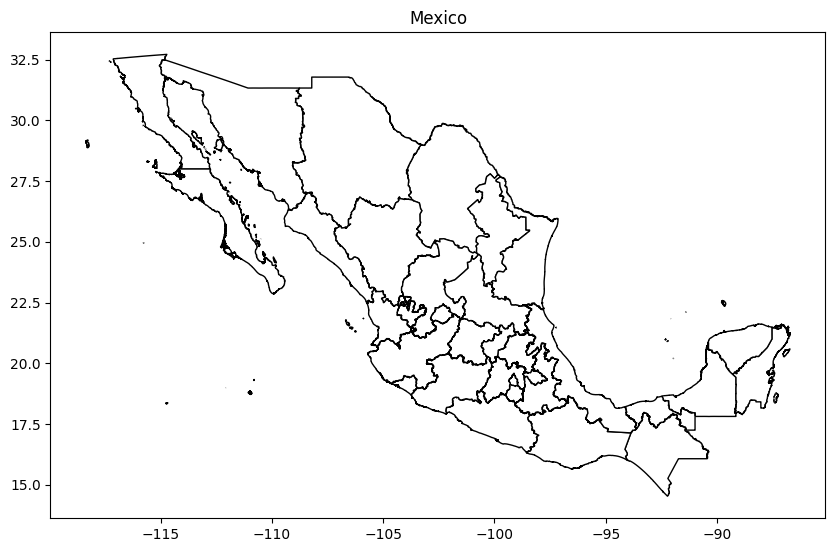

In [4]:
# plot mexico
gdf_mexico.plot(figsize=(10, 10), color='white', edgecolor='black')
plt.title('Mexico')

## H3 Coverage

### Geometry

In [5]:
# get full geometry
geom_mexico = gdf_mexico.geometry.union_all()

# see
geom_mexico

In [6]:
# buffer 5km geom_mexico
gdf_mexico_buffered = gdf_mexico.copy()
gdf_mexico_buffered['geometry'] = gdf_mexico_buffered.to_crs(epsg=6372)['geometry'].buffer(10_000).to_crs(epsg=4326)

In [7]:
# look buffered geometry
gdf_mexico_buffered.explore(figsize=(10, 10), color='white', edgecolor='black')

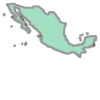

In [8]:
# see if the buffer is correct
gdf_mexico_buffered.geometry.buffer(0).union_all()

### Grids

In [25]:
# teselate mexico with h3 hex resolution fixed
resolution = 5
h3_mexico = list(set(h3.geo_to_cells(gdf_mexico_buffered.geometry.buffer(0).union_all(), res=resolution)))

# total hexagons
print(len(h3_mexico))
h3_mexico

7295


['8549b0cffffffff',
 '85487347fffffff',
 '85488087fffffff',
 '8548b0d3fffffff',
 '8549b013fffffff',
 '8549b093fffffff',
 '8548b5c7fffffff',
 '856d25abfffffff',
 '8548559bfffffff',
 '8548295bfffffff',
 '8549aa4ffffffff',
 '8545295bfffffff',
 '856d2103fffffff',
 '8548c6b3fffffff',
 '85480b8ffffffff',
 '85481e63fffffff',
 '8548b39bfffffff',
 '8548ab53fffffff',
 '856d3283fffffff',
 '856d2153fffffff',
 '85452ba3fffffff',
 '85499a03fffffff',
 '8548530ffffffff',
 '8545292bfffffff',
 '8548141bfffffff',
 '854850c7fffffff',
 '854819a7fffffff',
 '8529a48bfffffff',
 '85499d57fffffff',
 '85485637fffffff',
 '85485227fffffff',
 '854984a7fffffff',
 '8549801bfffffff',
 '8548730ffffffff',
 '854501abfffffff',
 '85480587fffffff',
 '8545720ffffffff',
 '85481553fffffff',
 '8548e3bbfffffff',
 '8548f46bfffffff',
 '854989cbfffffff',
 '8549a24bfffffff',
 '8549b327fffffff',
 '85498923fffffff',
 '8548424bfffffff',
 '85450b1bfffffff',
 '854881c7fffffff',
 '8548728bfffffff',
 '85487653fffffff',
 '85482a93fffffff',


In [10]:
# h3 hexes to dataframe
df_h3_mexico = pd.DataFrame(h3_mexico, columns=['h3_id'])

# look
df_h3_mexico.head()

,h3_id
0,8549b0cffffffff
1,85487347fffffff
2,85488087fffffff
3,8548b0d3fffffff
4,8549b013fffffff


In [11]:
# add geometry
df_h3_mexico['geometry'] = df_h3_mexico['h3_id'].apply(h3.cell_to_boundary)

# invert geometry
df_h3_mexico['geometry'] = df_h3_mexico['geometry'].apply(
    lambda z: Polygon(tuple(x[::-1] for x in z))
)
                                                          
# convert to geodataframe
df_h3_mexico = gpd.GeoDataFrame(df_h3_mexico, geometry='geometry', crs='EPSG:4326')

# eliminate rows that geometry does not intersect with gdf_mexico
df_h3_mexico = df_h3_mexico[
    df_h3_mexico.geometry.intersects(gdf_mexico.geometry.union_all())
]

# look
df_h3_mexico

,h3_id,geometry
0,8549b0cffffffff,"POLYGON ((-98.81203 17.01364, -98.75224 17.090..."
1,85487347fffffff,"POLYGON ((-113.39278 27.69632, -113.33624 27.7..."
2,85488087fffffff,"POLYGON ((-100.2384 27.56075, -100.17389 27.63..."
3,8548b0d3fffffff,"POLYGON ((-97.73754 24.7451, -97.67368 24.8211..."
4,8549b013fffffff,"POLYGON ((-99.10621 17.04353, -99.04649 17.120..."
...,...,...
7290,856d3677fffffff,"POLYGON ((-96.91738 17.79964, -96.85674 17.875..."
7291,8548a22ffffffff,"POLYGON ((-100.43093 26.06628, -100.36727 26.1..."
7292,856d350bfffffff,"POLYGON ((-94.99447 17.81644, -94.93347 17.891..."
7293,856d346bfffffff,"POLYGON ((-96.12741 18.12003, -96.06645 18.195..."


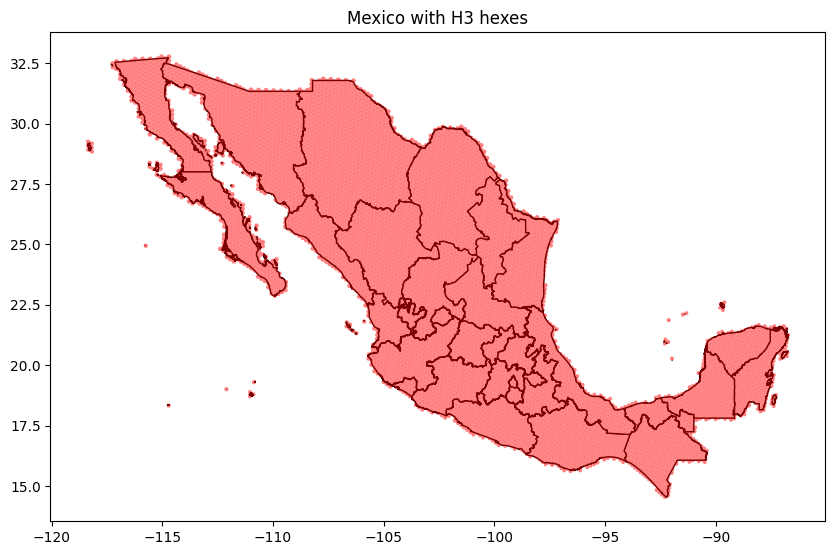

In [12]:
# plot h3 on top of mexico
ax = gdf_mexico.plot(figsize=(10, 10), color='white', edgecolor='black')

df_h3_mexico.plot(ax=ax, color='red', alpha=0.5)
plt.title('Mexico with H3 hexes')
plt.show()

In [13]:
# explore h3 hexes
df_h3_mexico.explore(tiles='cartodb positron')

In [14]:
# get center of hexes using lat and lon
df_h3_mexico['longitude'] = df_h3_mexico['geometry'].apply(lambda x: x.centroid.x)
df_h3_mexico['latitude'] = df_h3_mexico['geometry'].apply(lambda x: x.centroid.y)

# look
df_h3_mexico.head()

,h3_id,geometry,longitude,latitude
0,8549b0cffffffff,"POLYGON ((-98.81203 17.01364, -98.75224 17.090...",-98.850277,17.100190
1,85487347fffffff,"POLYGON ((-113.39278 27.69632, -113.33624 27.7...",-113.445454,27.780920
2,85488087fffffff,"POLYGON ((-100.2384 27.56075, -100.17389 27.63...",-100.281296,27.649520
3,8548b0d3fffffff,"POLYGON ((-97.73754 24.7451, -97.67368 24.8211...",-97.777197,24.834018
4,8549b013fffffff,"POLYGON ((-99.10621 17.04353, -99.04649 17.120...",-99.144714,17.130107


In [15]:
# total data points
print(f'Total hexagons: {len(df_h3_mexico)}')
print(f'Total hours: {5 * 365 * 24}')
print(f'Total data points: {len(df_h3_mexico) * 5 * 365 * 24}')

Total hexagons: 7278
Total hours: 43800
Total data points: 318776400


---
# NASA POWER data

## Time series of 1 hex


In [16]:
# API
api_template = "https://power.larc.nasa.gov/api/temporal/hourly/point?parameters=T2M&community=RE&longitude={lon}&latitude={lat}&start={start}&end={end}&format=JSON&user_id={user_id}&time-standard=LST"

In [17]:
# example 854995bbfffffff
h3_id = '854995bbfffffff'
row_h3 = df_h3_mexico.query('h3_id == @h3_id').iloc[0]
row_h3

h3_id                                          854995bbfffffff
geometry     POLYGON ((-99.10330037561077 19.36900079088934...
longitude                                           -99.142505
latitude                                             19.456595
Name: 706, dtype: object

In [18]:
# example api call
api_call = api_template.format(
    lon=row_h3['longitude'],
    lat=row_h3['latitude'],
    start='20220101',
    end='20221231',
    user_id='roman_avj'
)

# look
print(api_call)

https://power.larc.nasa.gov/api/temporal/hourly/point?parameters=T2M&community=RE&longitude=-99.1425051662781&latitude=19.45659507000951&start=20220101&end=20221231&format=JSON&user_id=roman_avj&time-standard=LST


In [19]:
# request
response = requests.get(api_call)

# look
print(response.status_code)
print(response.json())
print(response.json().keys())

200
{'type': 'Feature', 'geometry': {'type': 'Point', 'coordinates': [-99.143, 19.457, 2626.86]}, 'properties': {'parameter': {'T2M': {'2022010100': 8.11, '2022010101': 7.9, '2022010102': 7.6, '2022010103': 7.17, '2022010104': 6.75, '2022010105': 6.32, '2022010106': 6.44, '2022010107': 10.12, '2022010108': 14.28, '2022010109': 18.0, '2022010110': 20.13, '2022010111': 21.55, '2022010112': 22.33, '2022010113': 22.41, '2022010114': 21.97, '2022010115': 20.75, '2022010116': 17.19, '2022010117': 13.26, '2022010118': 10.72, '2022010119': 8.73, '2022010120': 8.02, '2022010121': 7.69, '2022010122': 7.33, '2022010123': 7.09, '2022010200': 6.96, '2022010201': 7.08, '2022010202': 6.99, '2022010203': 6.2, '2022010204': 5.2, '2022010205': 4.53, '2022010206': 5.0, '2022010207': 10.12, '2022010208': 14.6, '2022010209': 17.59, '2022010210': 19.17, '2022010211': 20.01, '2022010212': 20.28, '2022010213': 20.06, '2022010214': 19.44, '2022010215': 18.0, '2022010216': 14.45, '2022010217': 9.79, '2022010218

In [20]:
# get data
response.json()['properties']['parameter']['T2M']

{'2022010100': 8.11,
 '2022010101': 7.9,
 '2022010102': 7.6,
 '2022010103': 7.17,
 '2022010104': 6.75,
 '2022010105': 6.32,
 '2022010106': 6.44,
 '2022010107': 10.12,
 '2022010108': 14.28,
 '2022010109': 18.0,
 '2022010110': 20.13,
 '2022010111': 21.55,
 '2022010112': 22.33,
 '2022010113': 22.41,
 '2022010114': 21.97,
 '2022010115': 20.75,
 '2022010116': 17.19,
 '2022010117': 13.26,
 '2022010118': 10.72,
 '2022010119': 8.73,
 '2022010120': 8.02,
 '2022010121': 7.69,
 '2022010122': 7.33,
 '2022010123': 7.09,
 '2022010200': 6.96,
 '2022010201': 7.08,
 '2022010202': 6.99,
 '2022010203': 6.2,
 '2022010204': 5.2,
 '2022010205': 4.53,
 '2022010206': 5.0,
 '2022010207': 10.12,
 '2022010208': 14.6,
 '2022010209': 17.59,
 '2022010210': 19.17,
 '2022010211': 20.01,
 '2022010212': 20.28,
 '2022010213': 20.06,
 '2022010214': 19.44,
 '2022010215': 18.0,
 '2022010216': 14.45,
 '2022010217': 9.79,
 '2022010218': 7.5,
 '2022010219': 5.54,
 '2022010220': 4.09,
 '2022010221': 3.41,
 '2022010222': 3.15,


In [21]:
# to dataframe, where the response is in properties --> parameters --> T2M
df_temp = pd.DataFrame.from_dict(
    response.json()['properties']['parameter']['T2M'],
    orient='index',
    columns=['temperature']
)

# name the index
df_temp.index.name = 'date'

# index to datetime in format YYYYMMDDHH
df_temp.index = pd.to_datetime(df_temp.index, format='%Y%m%d%H')

# look
df_temp.head()

,temperature
date,
2022-01-01 00:00:00,8.11
2022-01-01 01:00:00,7.90
2022-01-01 02:00:00,7.60
2022-01-01 03:00:00,7.17
2022-01-01 04:00:00,6.75


<Axes: title={'center': 'Temperature in Mexico'}, xlabel='date'>

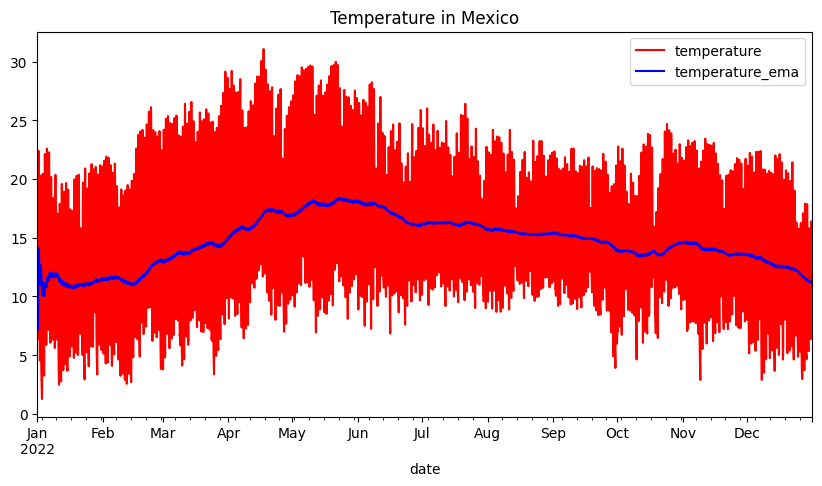

In [22]:
# plot
# add exponential moving average of the month
df_temp['temperature_ema'] = df_temp['temperature'].ewm(span=24 * 30-4).mean()

# plot
df_temp[['temperature', 'temperature_ema']].plot(figsize=(10, 5), title='Temperature in Mexico', color=['red', 'blue'])

In [23]:
df_temp['temperature_ema']

date
2022-01-01 00:00:00     8.110000
2022-01-01 01:00:00     8.004853
2022-01-01 02:00:00     7.869525
2022-01-01 03:00:00     7.693910
2022-01-01 04:00:00     7.504072
                         ...    
2022-12-31 19:00:00    11.248394
2022-12-31 20:00:00    11.242652
2022-12-31 21:00:00    11.236703
2022-12-31 22:00:00    11.230213
2022-12-31 23:00:00    11.222904
Name: temperature_ema, Length: 8760, dtype: float64

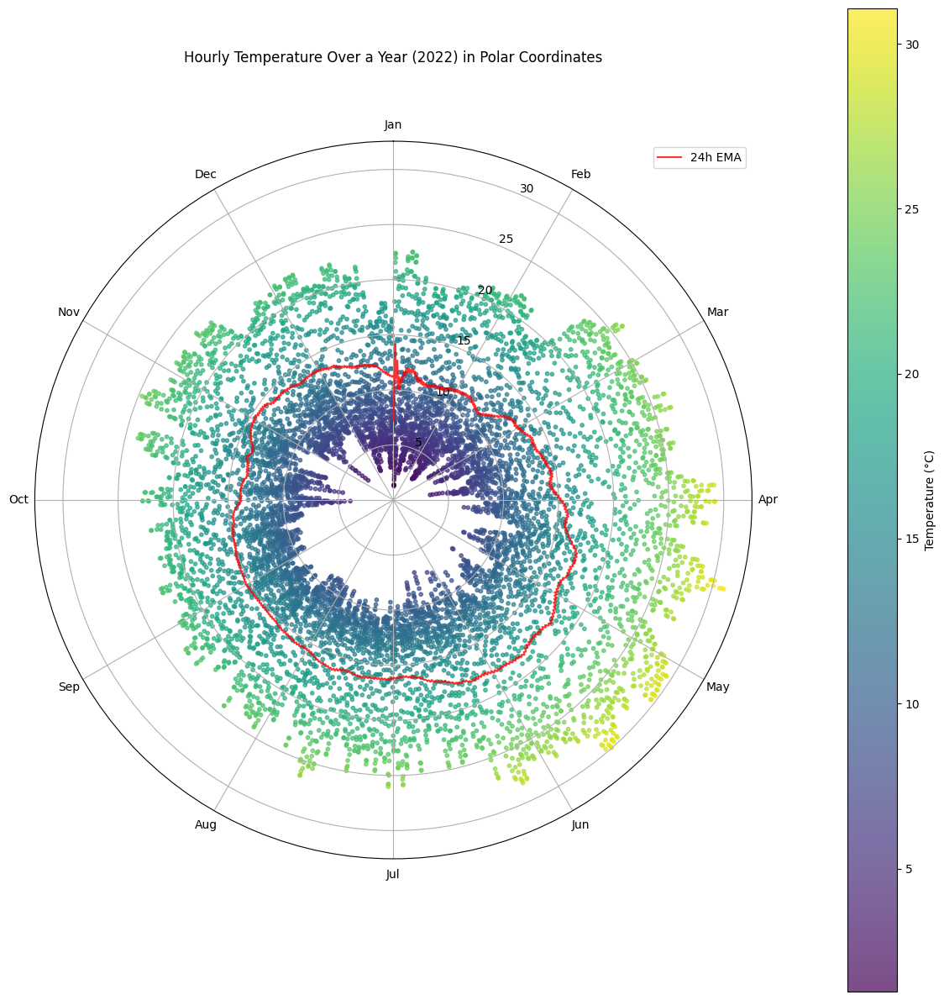

In [24]:
# Convert the datetime index to angles and prepare data for polar plot
fig = plt.figure(figsize=(12, 12))
ax = plt.subplot(111, projection='polar')

# Convert datetime to angle (0 to 2*pi represents a full year)
days_in_year = 365
hours_in_day = 24
total_hours = days_in_year * hours_in_day

# Create angle values (theta) for each hour in the year
theta = 2 * np.pi * np.arange(len(df_temp)) / total_hours

# Use temperature as radius
radius = df_temp['temperature']
radius_ema = df_temp['temperature_ema']

# Create a colormap based on temperature values
sc = ax.scatter(theta, radius, c=radius, cmap='viridis', alpha=0.7, s=10)

# Add EMA as a line
ax.plot(theta, radius_ema, color='red', linewidth=1.5, alpha=0.8, label='24h EMA')

# Set the direction of the zero angle (top)
ax.set_theta_zero_location("N")
# Set the direction to clockwise
ax.set_theta_direction(-1)

# Add month labels at appropriate positions
month_names = ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 
               'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec']
month_angles = np.linspace(0, 2*np.pi, 13)[:-1]  # 12 months evenly spaced
ax.set_xticks(month_angles)
ax.set_xticklabels(month_names)

# Add a colorbar
cbar = plt.colorbar(sc, pad=0.1)
cbar.set_label('Temperature (°C)')

# Add legend
ax.legend(loc='upper right')

# Add title
plt.title('Hourly Temperature Over a Year (2022) in Polar Coordinates', y=1.1)

plt.tight_layout()
plt.show()

---
# Sandbox